In [1]:
'''
NTK이론을 바탕으로 Fourier-featuring이 MLP로 하여금 high frequency부분이 잘 학습할 수 있게 한다


**Coordinate-based MLP
input : pixel 정보
output : 여러가지   
Fully connected layer

** MLP가 spectral bias 에 의해 high frequency부분을 잘 학습하지 못해
Positional Encoding 중의 하나인 Fourier-featuring을 사용하면 잘 학습할 수 있다.

왜 Fourier-featuring을 사용하면 잘 학습?  
A :이걸 NTK로 증명한 것이 이 논문의 contribution입니다 

'''

'\nNTK이론을 바탕으로 Fourier-featuring이 MLP로 하여금 high frequency부분이 잘 학습할 수 있게 한다\n\n\n**Coordinate-based MLP\ninput : pixel 정보\noutput : 여러가지   \nFully connected layer\n\n** MLP가 spectral bias 에 의해 high frequency부분을 잘 학습하지 못해\nPositional Encoding 중의 하나인 Fourier-featuring을 사용하면 잘 학습할 수 있다.\n\n왜 Fourier-featuring을 사용하면 잘 학습?  \nA :이걸 NTK로 증명한 것이 이 논문의 contribution입니다 \n\n'

In [2]:
'''
***Kernel Method
Input space의 데이터를 선형분류가 가능한 고차원 공간으로 mapping한 뒤 두 범주를 분류하는 초평면을 찾는다

***kernel regression
linear regression과 달리 비선형 함수 같은 것을 regression 방법론
why? 자연상에 존재하는 비선형성을 찾는 것  ==이므로 kernel regrssion과 동치다

x는 새로운 데이터 xi가 원래 있는 데이터이고 원래 있는데이터를 학습해 새로들어온 데이터가 얼마나 유사한지 계산해서 weighted sum으로 분류하는 과정

***NTK
kernel regression을 이용해 Neural Network의 작동 원리를 설명하려는 방법론
목표 : MLP를 Kernel 함수꼴로 재정의하기

positon encoding이 왜 수렴에 효과적인지 증명하기 위해서 MLP를 kernel 함수로 재정의하는데 그 떄 사용되는게 NTK이다
'''
'''
MLP를 Kernel함수로 고치는 것이 왜 필요한가
1. MLP가 High frequency를 잘 학습하지 못하는 이유를 이해
-> 증명  : 수렴 속도는 그 성분의 eigenvalue에 의해 결정된다.
QT(yˆ(t) −y)≈QT  I−e−ηKty−y=−e−ηΛtQTy.



2. Positional Encoding같은 fourier-featuring을 첨가했을 때 학습이 잘 되는 이유를 이해
-> 증명 : Fourier-featuring을 첨가하면 데이터는 stationary(같은 패턴이 반복되는 성질)한 성질을 가짐 & MLP는 convolution된다
잊혀질수 있는데이터가 계속 반복되기 때문에 충분히 학습할 수 있는 여지를 준다
'''


'\nMLP를 Kernel함수로 고치는 것이 왜 필요한가\n1. MLP가 High frequency를 잘 학습하지 못하는 이유를 이해\n-> 증명  : 수렴 속도는 그 성분의 eigenvalue에 의해 결정된다.\n\n2.\n'

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
from tqdm import tqdm
import sys
import imageio
import math
print(os.getcwd())
device= torch.device('cuda' if torch.cuda.is_available else 'cpu')
print(device)

/home/lab/anaconda3/envs/prac/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


/ssd1/Fourier
cuda


In [3]:
def psnr(label, outputs, max_val=1.):
    label = label.cpu().detach().numpy()
    outputs = outputs.cpu().detach().numpy()
    img_diff = outputs - label
    rmse = math.sqrt(np.mean((img_diff)**2))
    if rmse == 0: # label과 output이 완전히 일치하는 경우
        return 100
    else:
        psnr = 20 * math.log10(max_val/rmse)
        return psnr

In [4]:

img=plt.imread('15677707699_d9d67acf9d_b.jpg')
img=img[...,:3] /255.
print(img.shape)
print(img.dtype)
c=[img.shape[0]//2,img.shape[1]//2]
r=256
img = img[c[0] - r:c[0] + r, c[1] - r:c[1] + r]
img.shape

(689, 1024, 3)
float64


(512, 512, 3)

tensor([[[[0.1922, 0.1373, 0.1176,  ..., 0.1765, 0.1882, 0.1961],
          [0.1608, 0.1569, 0.1451,  ..., 0.1765, 0.2000, 0.1961],
          [0.1725, 0.1804, 0.1725,  ..., 0.1961, 0.2039, 0.1804],
          ...,
          [0.2078, 0.1765, 0.1647,  ..., 0.7451, 0.6941, 0.6471],
          [0.1961, 0.1686, 0.1529,  ..., 0.8627, 0.8118, 0.7569],
          [0.1922, 0.1725, 0.1529,  ..., 0.9098, 0.8784, 0.8314]],

         [[0.2275, 0.1961, 0.2118,  ..., 0.2118, 0.2000, 0.1961],
          [0.1804, 0.2078, 0.2235,  ..., 0.2118, 0.2118, 0.2078],
          [0.1765, 0.2157, 0.2392,  ..., 0.2196, 0.2196, 0.2039],
          ...,
          [0.2157, 0.1961, 0.2039,  ..., 0.5882, 0.5725, 0.5529],
          [0.1922, 0.1843, 0.1922,  ..., 0.6902, 0.6745, 0.6588],
          [0.1882, 0.1882, 0.2039,  ..., 0.7333, 0.7373, 0.7373]],

         [[0.1216, 0.1059, 0.1098,  ..., 0.0902, 0.0863, 0.0863],
          [0.0627, 0.1059, 0.1137,  ..., 0.0980, 0.1059, 0.1020],
          [0.0549, 0.1020, 0.1137,  ..., 0

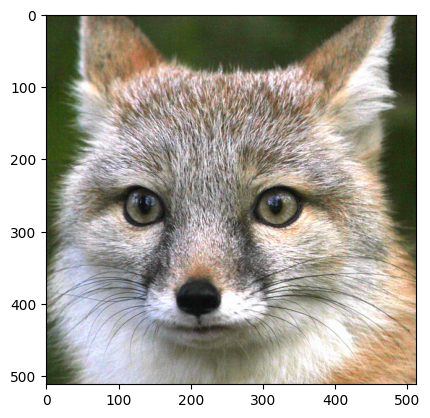

In [5]:
target=torch.tensor(img).unsqueeze(0).permute(0, 3, 1, 2).to(device)
print(target)
print(target.dtype)
#이미지 확인
sample=np.array(target[0].permute(1,2,0).cpu())
plt.imshow(sample)




coords=np.linspace(0,1,target.shape[2],endpoint=False)
print(coords.shape)
xy_grid=np.stack(np.meshgrid(coords,coords),-1)
print(xy_grid.shape)
xy_grid = torch.tensor(xy_grid).unsqueeze(0).permute(0, 3, 1, 2).float().contiguous().to(device)
print(xy_grid.shape)

## NO mapping 


###  MLP

In [8]:
class MLP(nn.Module) :
    def __init__(self) :
        super().__init__()

        self.linear=nn.Sequential(nn.Linear(524288,3),
                                  nn.ReLU(),
                                  nn.Linear(3,3),
                                  nn.ReLU(),
                                  nn.Linear(3,786432),
                                  nn.ReLU()
                                  )
    
    def forward(self,x) :
        x=torch.flatten(x,start_dim=1)
        x=self.linear(x)
        return x
        

In [9]:
model=MLP()
model=model.to(device)
optimizer=optim.Adam(list(model.parameters()),lr=1e-4)
generated=model(xy_grid)

generated=generated.reshape(1,3,512,512)
print(generated.dtype)
print(target.dtype)
print(target.shape)
print(nn.MSELoss()(generated,target))

torch.float32
torch.float64
torch.Size([1, 3, 512, 512])
tensor(0.2698, device='cuda:0', dtype=torch.float64,
       grad_fn=<MseLossBackward0>)


  0%|          | 0/2000 [00:00<?, ?it/s]

Epoch 0, loss = 0.268


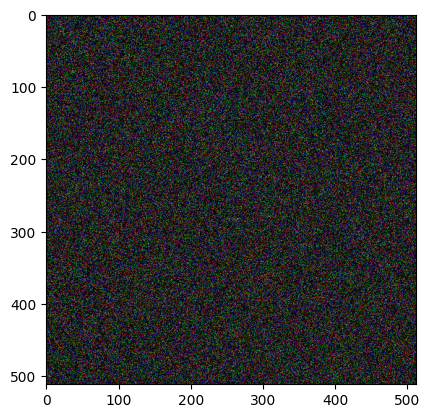

 25%|██▍       | 497/2000 [00:03<00:11, 135.03it/s]

Epoch 500, loss = 0.253


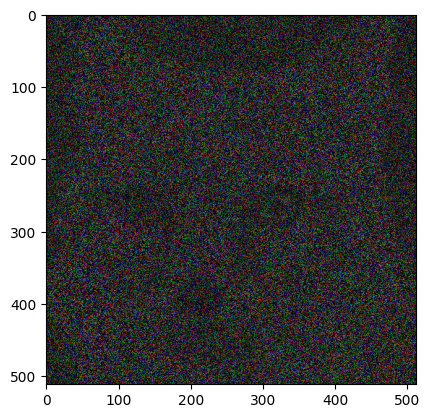

 49%|████▉     | 989/2000 [00:07<00:08, 123.13it/s]

Epoch 1000, loss = 0.241


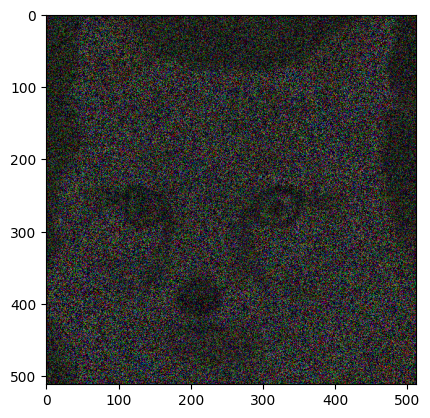

 75%|███████▌  | 1500/2000 [00:11<00:03, 139.16it/s]

Epoch 1500, loss = 0.231


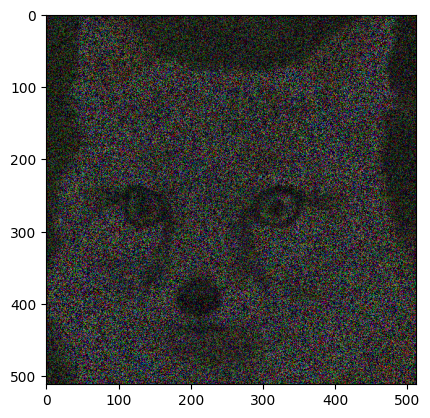

100%|██████████| 2000/2000 [00:15<00:00, 129.32it/s]


In [38]:
model=MLP()
model=model.to(device)
optimizer=optim.Adam(list(model.parameters()),lr=1e-4)
e1_loss,e1_psnr=[],[]
for epoch in tqdm(range(2000)) :
    optimizer.zero_grad()
    generated=model(xy_grid)
    generated=generated.reshape(1,3,512,512)
    #loss=nn.L1Loss()(target.detach(),generated)
    loss = nn.MSELoss()(generated,target.float())
    e1_loss.append(loss.item())
    loss.backward()
    e_psnr=psnr(generated,target)
    e1_psnr+=[e_psnr]
    optimizer.step()

    if epoch%500==0 :
        print('Epoch %d, loss = %.03f' % (epoch, float(loss)))
        plt.imshow(generated[0].permute(1,2,0).cpu().detach().numpy())
        plt.show()



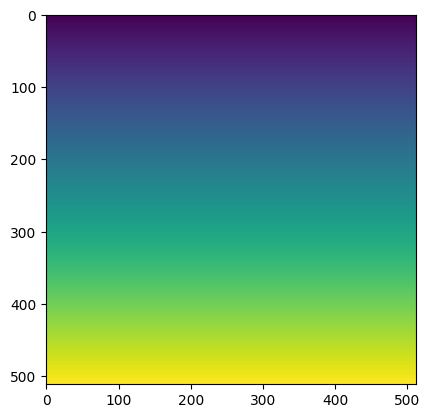

In [40]:
xy_grid.shape
y=xy_grid.cpu()
y=(y[0][1].numpy())
plt.imshow(y)

### CNN-MLP

In [15]:
class CNN_MLP(nn.Module) :
    def __init__(self) :
        super().__init__()
        self.mlp=nn.Sequential(nn.Conv2d(2,256,kernel_size=1,padding=0),
                               nn.ReLU(),
                               nn.BatchNorm2d(256),

                               nn.Conv2d(256,256,kernel_size=1,padding=0),
                               nn.ReLU(),
                               nn.BatchNorm2d(256),

                               nn.Conv2d(256,256,kernel_size=1,padding=0),
                               nn.ReLU(),
                               nn.BatchNorm2d(256),

                               nn.Conv2d(256,3,kernel_size=1,padding=0),
                               nn.Sigmoid()
                               )
    
    def forward(self,x) :
        x=self.mlp(x)
        return x
        

  0%|          | 0/2000 [00:00<?, ?it/s]

Epoch 0, loss = 0.075


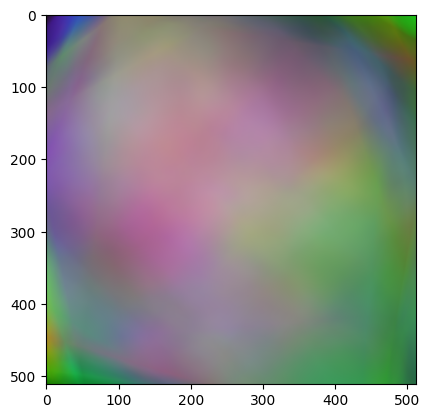

 10%|▉         | 199/2000 [00:07<01:03, 28.48it/s]

Epoch 200, loss = 0.014


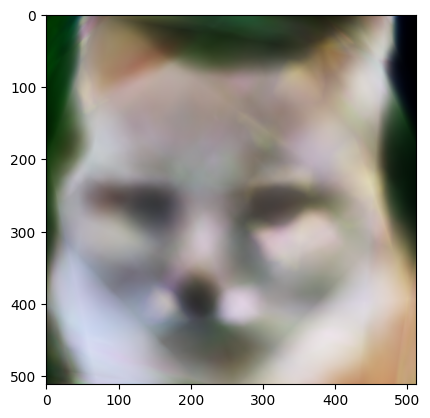

 20%|██        | 400/2000 [00:14<00:56, 28.43it/s]

Epoch 400, loss = 0.010


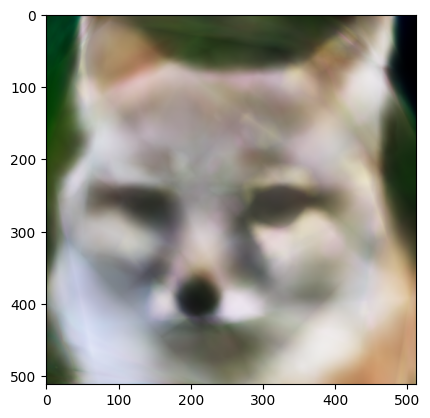

 30%|██▉       | 598/2000 [00:21<00:49, 28.56it/s]

Epoch 600, loss = 0.009


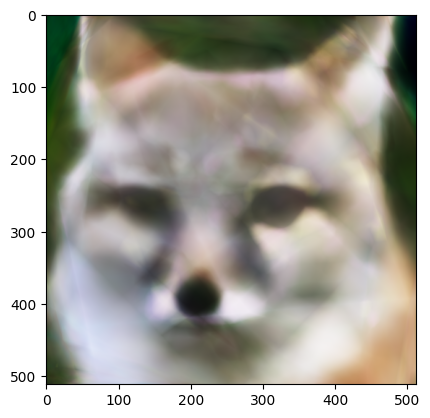

 40%|████      | 800/2000 [00:28<00:42, 28.52it/s]

Epoch 800, loss = 0.009


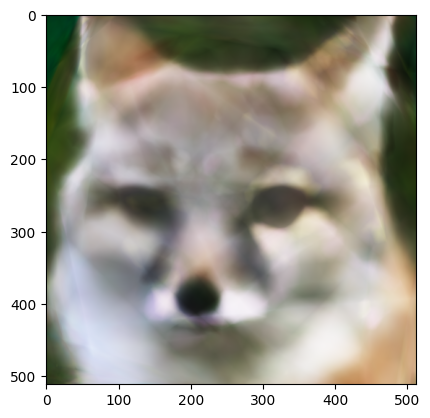

 50%|████▉     | 998/2000 [00:35<00:35, 28.55it/s]

Epoch 1000, loss = 0.009


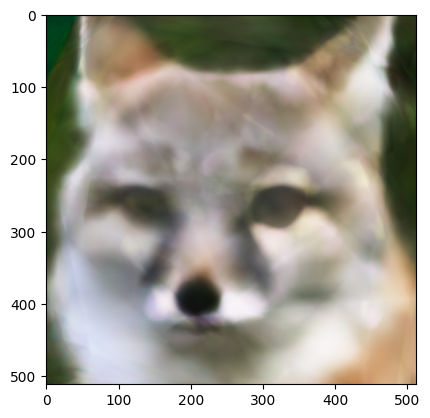

 60%|██████    | 1200/2000 [00:43<00:28, 28.46it/s]

Epoch 1200, loss = 0.009


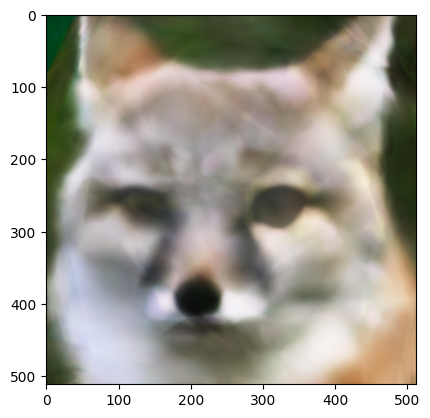

 70%|██████▉   | 1398/2000 [00:50<00:21, 28.48it/s]

Epoch 1400, loss = 0.008


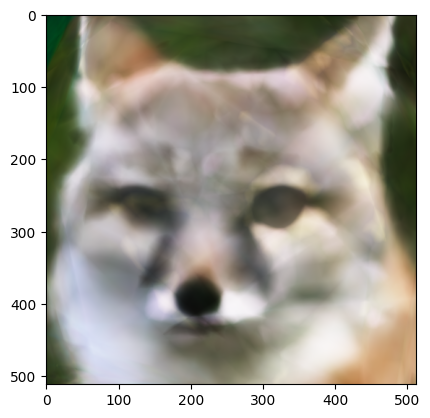

 80%|████████  | 1600/2000 [00:57<00:14, 28.48it/s]

Epoch 1600, loss = 0.008


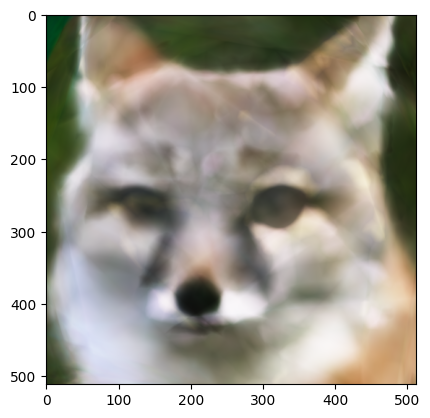

 90%|████████▉ | 1798/2000 [01:04<00:07, 28.51it/s]

Epoch 1800, loss = 0.008


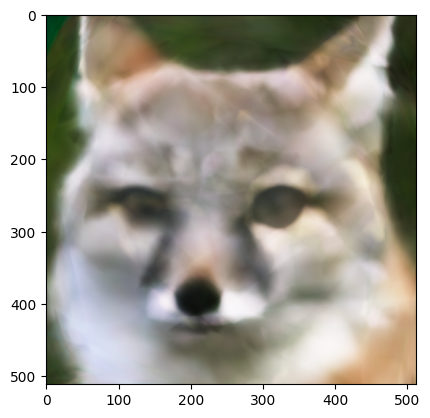

100%|██████████| 2000/2000 [01:11<00:00, 27.86it/s]


In [16]:
model=CNN_MLP()
model.to(device)
optimizer=optim.Adam(list(model.parameters()),lr=1e-4)
e2_loss=[]
e2_psnr=[]
for epoch in tqdm(range(2000)):
    optimizer.zero_grad()

    generated = model(xy_grid)
    
    
    #loss = nn.L1Loss()(generated,target)
    loss = nn.MSELoss()(generated,target.float())
    e2_loss.append(loss.item())
    e_psnr=psnr(generated,target)
    e2_psnr+=[e_psnr]
    loss.backward()
    optimizer.step()

    if epoch % 200 == 0:
      print('Epoch %d, loss = %.03f' % (epoch, float(loss)))
      plt.imshow(generated[0].permute(1,2,0).cpu().detach().numpy())
      plt.show()

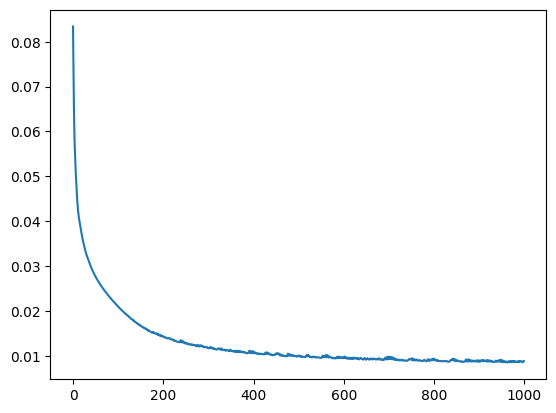

MLP와 CNN_MLP의 차이점 생각

## mapping

In [7]:
def mapping(grid,input_channel,mapping_size,scale) :
    b=torch.randn((input_channel,mapping_size))*scale
    batches, channels, width,height=grid.shape
    x = grid.permute(0, 2, 3, 1).reshape(batches * width * height, channels)
    x = x @ b.to(x.device)
    x = x.view(batches, width, height, mapping_size)
    x = x.permute(0, 3, 1, 2)
    x = 2 * np.pi * x
    return torch.cat([torch.sin(x), torch.cos(x)], dim=1)


class Gaussian(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.mlp=nn.Sequential(nn.Conv2d(256,256,1,padding=0),
                               nn.ReLU(),
                               nn.BatchNorm2d(256),
                               
                               nn.Conv2d(256,256,1,padding=0),
                               nn.ReLU(),
                               nn.BatchNorm2d(256),
                               
                               nn.Conv2d(256,256,1,padding=0),
                               nn.ReLU(),
                               nn.BatchNorm2d(256),
                               
                               nn.Conv2d(256,3,1,padding=0),
                               nn.Sigmoid()
                               )

    def forward(self, x):
        x=self.mlp(x)
        return x
b=torch.randn(2,5)
print(b)
b=torch.randn((2,128))*10

b.shape

tensor([[-0.8261,  0.8275, -1.9941,  0.5862,  0.0339],
        [ 0.5132, -0.6005,  0.6892,  0.3712, -0.2112]])


torch.Size([2, 128])

256


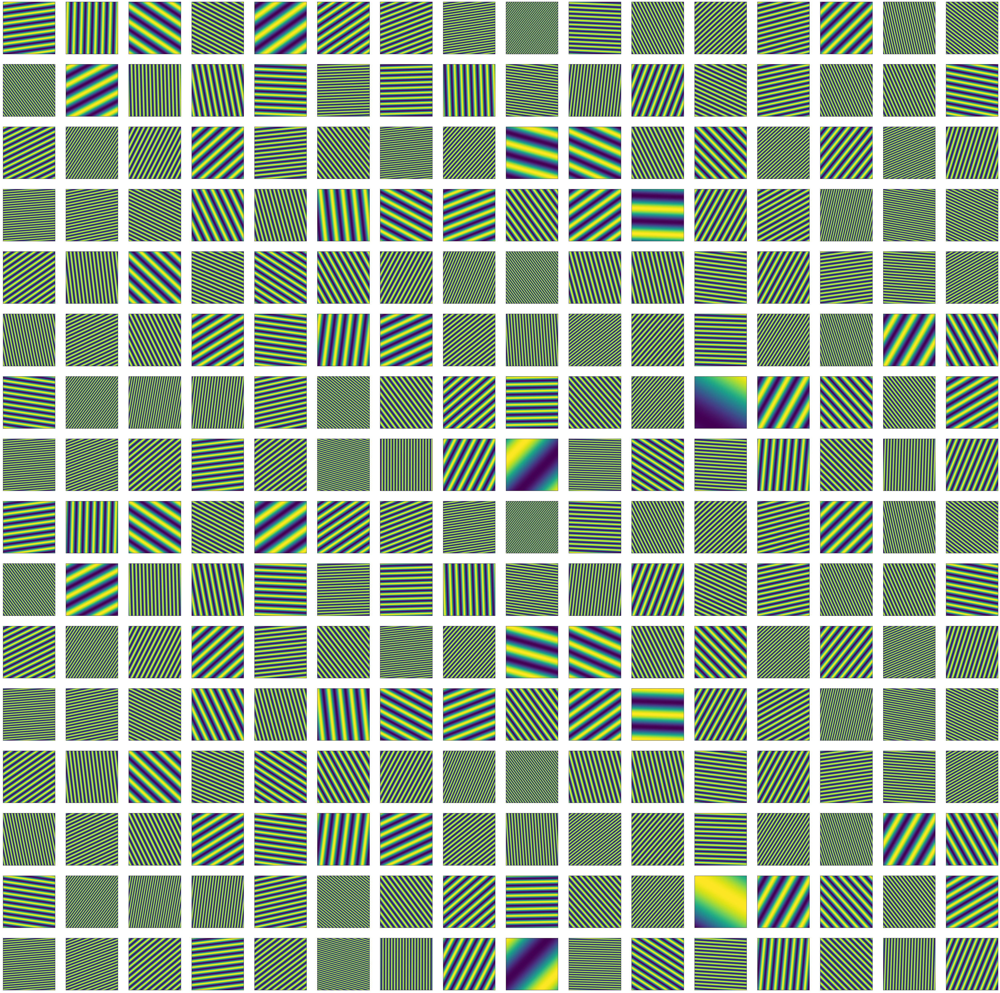

In [27]:
x=mapping(xy_grid,2,128,10)

print(x.shape[1])
y=x[0]
plt.figure(figsize=(64,64))
for idx in range(256) :
    t=y[idx]
    t=t.cpu().numpy()
    plt.subplot(16,16,idx+1,xticks=[],yticks=[])
    plt.imshow(t)

torch.Size([1, 256, 512, 512])


  0%|          | 0/2000 [00:00<?, ?it/s]

Epoch 0, loss = 0.08441197127103806


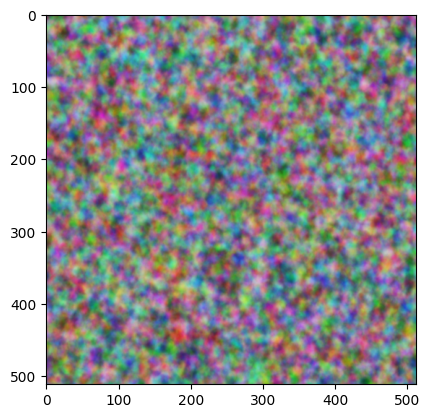

 10%|█         | 200/2000 [00:07<01:00, 29.77it/s]

Epoch 200, loss = 0.0069306837394833565


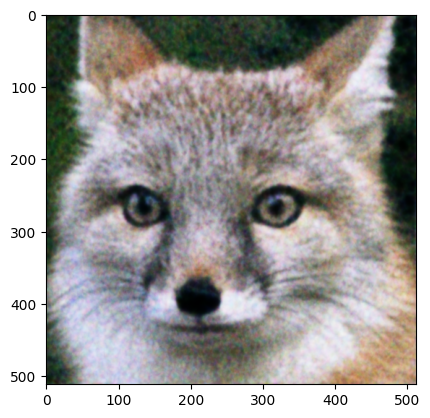

 20%|█▉        | 399/2000 [00:14<00:53, 29.73it/s]

Epoch 400, loss = 0.0045517864637076855


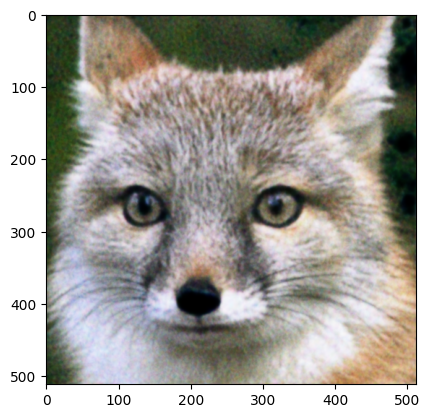

 30%|██▉       | 598/2000 [00:21<00:47, 29.75it/s]

Epoch 600, loss = 0.003554467810317874


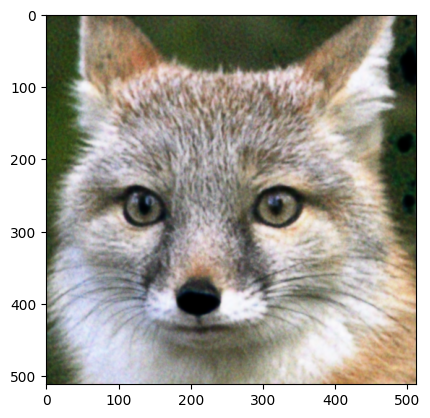

 40%|████      | 800/2000 [00:28<00:40, 29.71it/s]

Epoch 800, loss = 0.0029888805001974106


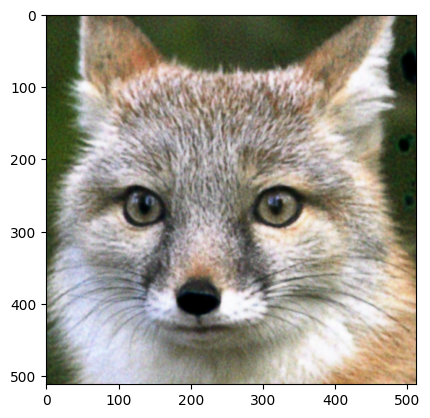

 50%|████▉     | 998/2000 [00:35<00:33, 29.68it/s]

Epoch 1000, loss = 0.0025697972159832716


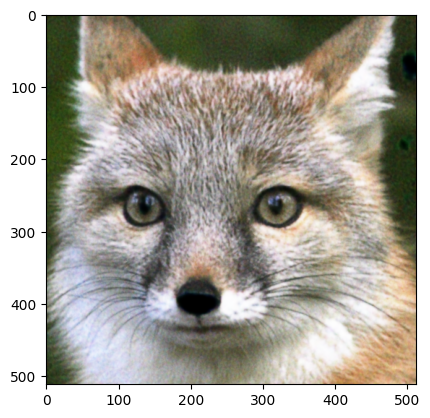

 60%|██████    | 1200/2000 [00:42<00:27, 29.46it/s]

Epoch 1200, loss = 0.0022183172404766083


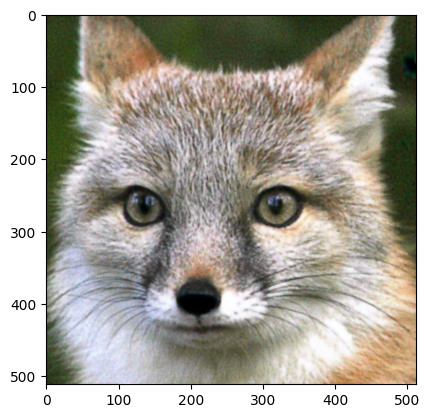

 70%|██████▉   | 1398/2000 [00:48<00:20, 29.63it/s]

Epoch 1400, loss = 0.0019209095044061542


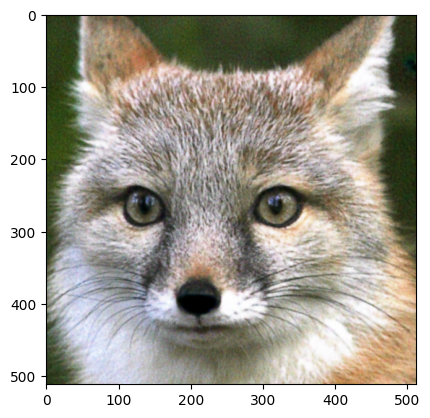

 80%|████████  | 1600/2000 [00:55<00:13, 29.67it/s]

Epoch 1600, loss = 0.001681850291788578


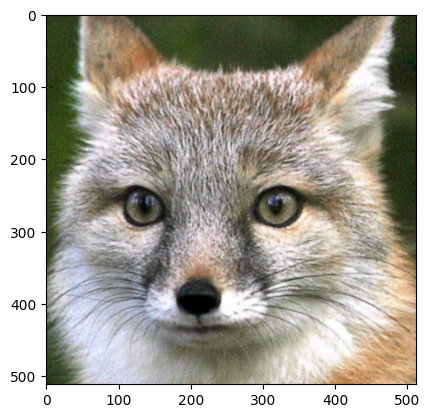

 90%|████████▉ | 1799/2000 [01:02<00:06, 29.66it/s]

Epoch 1800, loss = 0.0015092119574546814


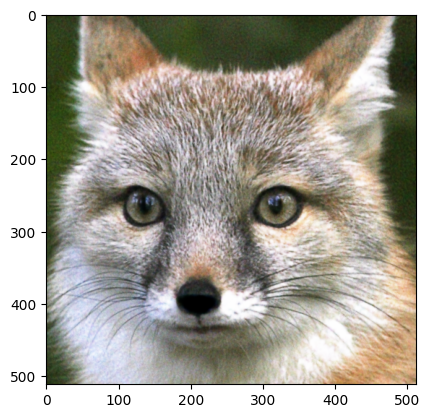

100%|██████████| 2000/2000 [01:09<00:00, 28.66it/s]


In [8]:
x=mapping(xy_grid,2,128,10)
print(x.shape)
model=Gaussian().to(device)
optimizer=optim.Adam(list(model.parameters()),lr=1e-4)
e3_loss,e3_psnr=[],[]
for epoch in tqdm(range(2000)) :
    optimizer.zero_grad()
    pred=model(x)
    #loss=nn.L1Loss()(pred,target)
    loss = nn.MSELoss()(pred,target.float())
    e3_loss.append(loss.item())
    e_psnr=psnr(pred,target)
    e3_psnr+=[e_psnr]
    loss.backward()
    optimizer.step()


    if epoch%200==0 :
        print(f'Epoch {epoch}, loss = {float(loss)}')
        plt.imshow(pred[0].permute(1,2,0).cpu().detach().numpy())
        plt.show()


NameError: name 'e2_loss' is not defined

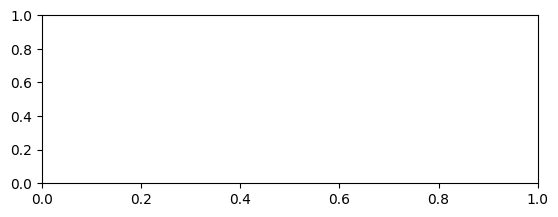

In [9]:
plt.subplot(211)
#plt.plot(range(2000),e1_loss)
plt.plot(range(2000),e2_loss)
plt.plot(range(2000),e3_loss)
plt.xlabel('Epoch')
plt.ylabel('Error')

plt.subplot(212)
#plt.plot(range(2000),e1_psnr)
plt.plot(range(2000),e2_psnr)
plt.plot(range(2000),e3_psnr)
plt.xlabel('Epoch')
plt.ylabel('PSNR')